<h1> Section 1: Business Understanding

This project focuses on analyzing Airbnb data obtained from Inside Airbnb. With a primary emphasis on user satisfaction, we aim to address the following three questions:

Question 1:  Which Amenities has more impact on Average Review Scores?

Question 2:  Which review_scores has the most influence on Average Total Review Score Rating?

Question 3:  Which host charectristics has the most influence on average review scores?

<h2>Importing Libraries

<h3> Installation

This code runs with Python version 3.* and requires some libraries, to install these libraries you will need to execute:

In [251]:
pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement sklearn==1.2.2 (from versions: 0.0, 0.0.post1, 0.0.post2, 0.0.post4, 0.0.post5)
ERROR: No matching distribution found for sklearn==1.2.2


In [246]:
import numpy as np
import pandas as pd
from wordcloud import WordCloud
import matplotlib
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk
nltk.download('vader_lexicon')
import sklearn
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import scipy
import scipy.stats as stats
import seaborn as sns
import markdown

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\enabi\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [249]:
print("numpy version:", np.__version__)
print("pandas version:", pd.__version__)
print("matplotlib version:", matplotlib.__version__)
print("nltk version:", nltk.__version__)
print("sklearn version:", sklearn.__version__)
print("markdown version:", markdown.__version__)
print("scipy version:", scipy.__version__)
print("seaborn version:", sns.__version__)

numpy version: 1.23.5
pandas version: 1.5.3
matplotlib version: 3.7.0
nltk version: 3.7
sklearn version: 1.2.2
markdown version: 3.4.1
scipy version: 1.10.0
seaborn version: 0.12.2


In [52]:

markdown_text = """
# Heading 1
## Heading 2
### Heading 3

Regular text in a larger font size:
^This text is larger.^

"""

# Convert Markdown text with the 'extra' extension
html = markdown.markdown(markdown_text, extensions=['markdown.extensions.extra'])

# Print or display the HTML
print(html)

<h1>Heading 1</h1>
<h2>Heading 2</h2>
<h3>Heading 3</h3>
<p>Regular text in a larger font size:
^This text is larger.^</p>


<h1>Section 2: Data Understanding

<h2> Data Gathering

In [53]:
df1= pd.read_csv('calendar.csv')

In [54]:
df1.head()

,listing_id,date,available,price
0,241032,2016-01-04,t,$85.00
1,241032,2016-01-05,t,$85.00
2,241032,2016-01-06,f,NaN
3,241032,2016-01-07,f,NaN
4,241032,2016-01-08,f,NaN


In [55]:
df2= pd.read_csv('listings.csv')

In [56]:
df2.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,...,10.0,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",...,10.0,f,NaN,WASHINGTON,f,strict,t,t,6,1.48


In [57]:
df3= pd.read_csv('reviews.csv')

In [58]:
df3.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,7202016,38917982,2015-07-19,28943674,Bianca,Cute and cozy place. Perfect location to every...
1,7202016,39087409,2015-07-20,32440555,Frank,Kelly has a great room in a very central locat...
2,7202016,39820030,2015-07-26,37722850,Ian,"Very spacious apartment, and in a great neighb..."
3,7202016,40813543,2015-08-02,33671805,George,Close to Seattle Center and all it has to offe...
4,7202016,41986501,2015-08-10,34959538,Ming,Kelly was a great host and very accommodating ...


<h2> Data Exploration & Visualization

In this part first, we check the size of the dataframes. As a first exploration, the vibe of each neighborhood is studied.

In [59]:
df1.shape

(1393570, 4)

In [60]:
df2.shape

(3818, 92)

In [61]:
df3.shape

(84849, 6)

Describtion of the vibe of each Seattle neighborhood using listing descriptions

In [62]:
df2['neighbourhood']

0        Queen Anne
1        Queen Anne
2        Queen Anne
3        Queen Anne
4        Queen Anne
           ...     
3813        Fremont
3814    Portage Bay
3815            NaN
3816            NaN
3817     Queen Anne
Name: neighbourhood, Length: 3818, dtype: object

In [63]:
df2['neighborhood_overview'].value_counts(dropna=False)

NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     

In [64]:
# Filling the nulls with no text for 'neighborhood_overview' column
df2['neighborhood_overview'].fillna('', inplace=True)

Above is the only column that I have filled for the NA values, in other places since I am comparing between different groups, I believe augmenting the data with mean or other values, will just increase the bias in the data set and does not add any specific value to our analysis. 

<h3> Neighborhood's vibe in Seattle

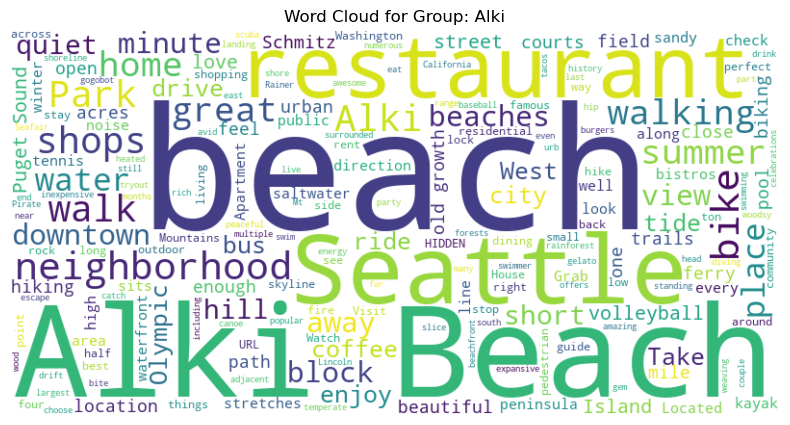

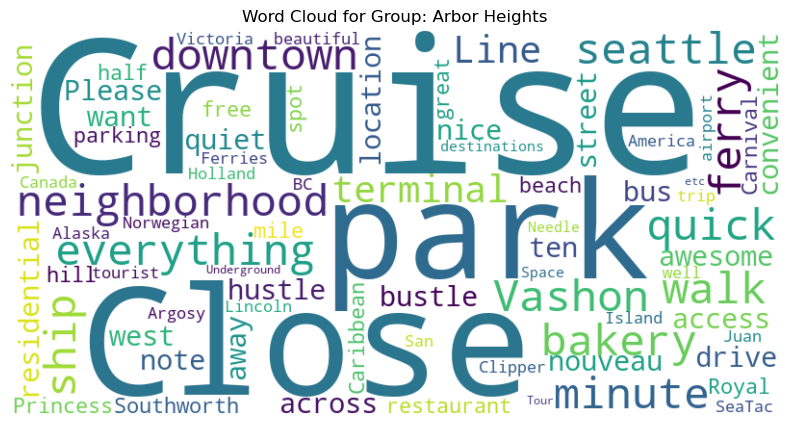

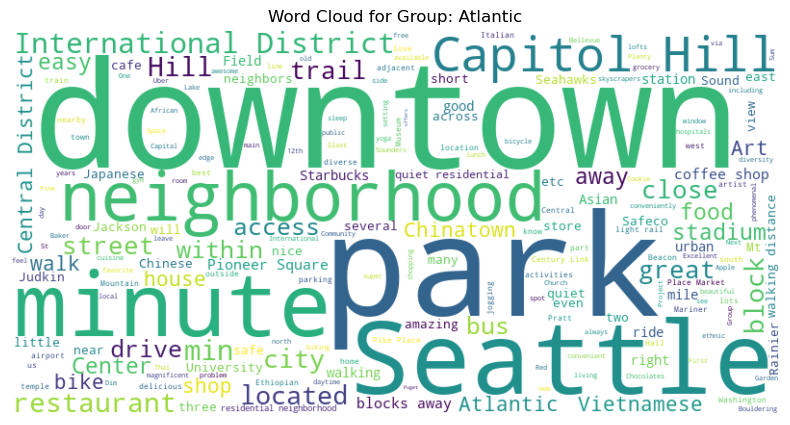

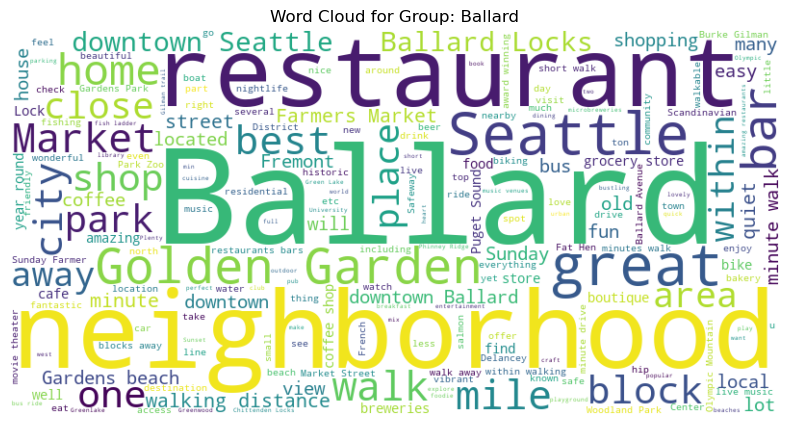

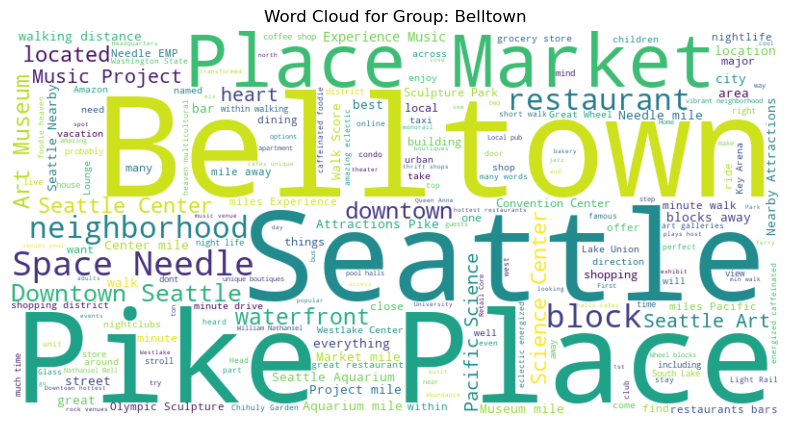

...

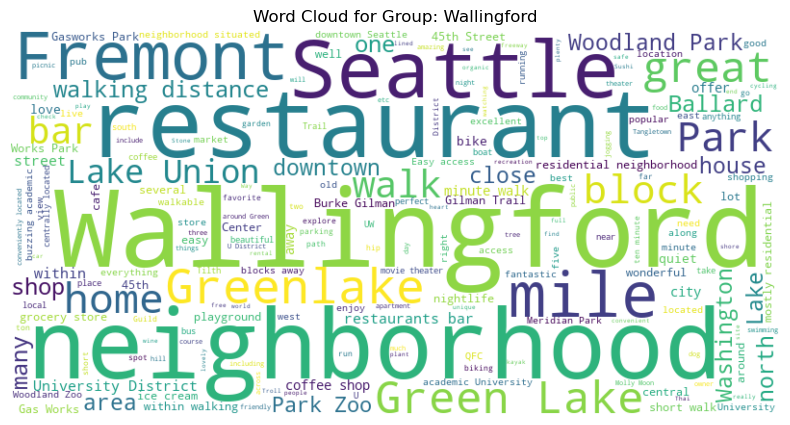

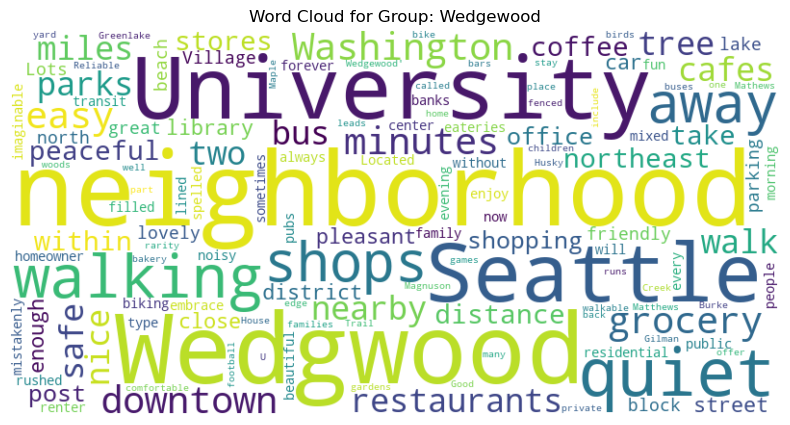

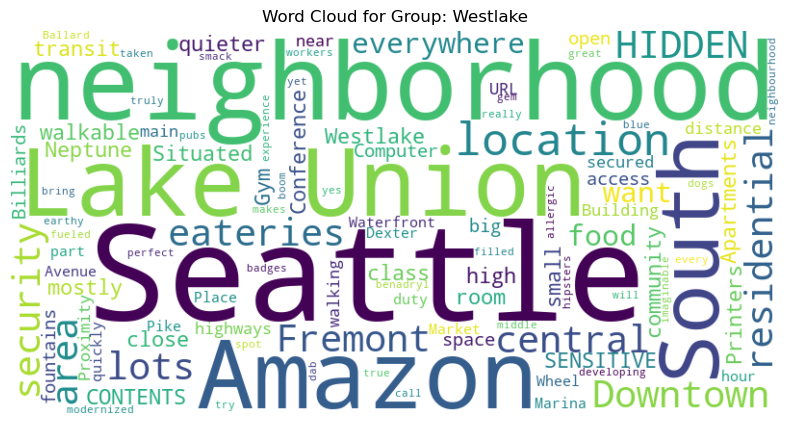

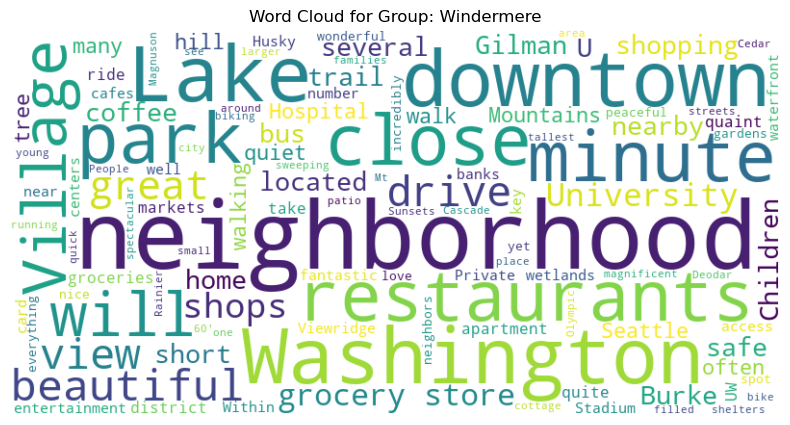

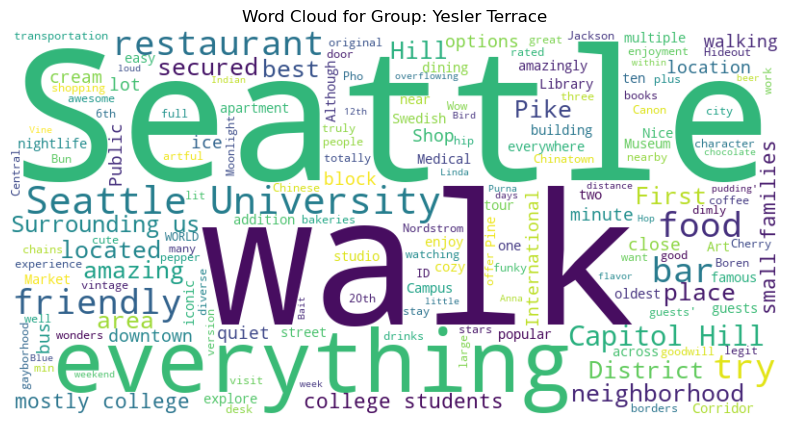

In [65]:
# Using WordCloud to show the vibes of each meighborhood,
# The bigger and bolder words, the more frequent in listing description for each neighborhood.

grouped = df2.groupby('neighbourhood')['neighborhood_overview'].apply(lambda x: ' '.join(x)).reset_index()

# Generate word clouds for each group
for index, row in grouped.iterrows():
    group = str(row['neighbourhood'])
    text = str(row['neighborhood_overview'])

    # Check if the text is empty or contains only whitespace
    if not text.strip():
        continue

    # Create word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

    # Plot the word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Group: {group}')
    plt.axis('off')
    plt.show()

In [66]:
# Sentiment analysis
# This part check the positive or negetive of each neighborhood based on the hosts' point of view.

# Initialize the SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()

# Perform sentiment analysis grouped by another column
grouped_sentiments = df2.groupby('neighbourhood')['neighborhood_overview'].apply(lambda x: x.apply(lambda y: sia.polarity_scores(y)['compound']).mean()).reset_index()
grouped_sentiments.columns = ['neighbourhood', 'group_sentiment']

# Classify sentiment based on the compound score
grouped_sentiments['sentiment_label'] = grouped_sentiments['group_sentiment'].apply(lambda x: 'Positive' if x >= 0 else 'Negative')

# Print the sentiment analysis results
print(grouped_sentiments[['neighbourhood', 'group_sentiment', 'sentiment_label']])

     neighbourhood  group_sentiment sentiment_label
0             Alki         0.476404        Positive
1    Arbor Heights         0.843067        Positive
2         Atlantic         0.316466        Positive
3          Ballard         0.572011        Positive
4         Belltown         0.311897        Positive
..             ...              ...             ...
76     Wallingford         0.559047        Positive
77       Wedgewood         0.431040        Positive
78        Westlake         0.253392        Positive
79      Windermere         0.474170        Positive
80  Yesler Terrace         0.449133        Positive

[81 rows x 3 columns]


In [67]:
grouped_sentiments['sentiment_label'].value_counts(dropna=False)

Positive    81
Name: sentiment_label, dtype: int64

As we expect, no HOST use negetive words about the vibe of their house's neighborhood :)
Let's check the positivity/ negitivity of each neighborhood based on the reviewrs' comments.

In [68]:
df3.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,7202016,38917982,2015-07-19,28943674,Bianca,Cute and cozy place. Perfect location to every...
1,7202016,39087409,2015-07-20,32440555,Frank,Kelly has a great room in a very central locat...
2,7202016,39820030,2015-07-26,37722850,Ian,"Very spacious apartment, and in a great neighb..."
3,7202016,40813543,2015-08-02,33671805,George,Close to Seattle Center and all it has to offe...
4,7202016,41986501,2015-08-10,34959538,Ming,Kelly was a great host and very accommodating ...


let's check the df2['id'] and df3['listing_id']

In [69]:
df2['id']

0         241032
1         953595
2        3308979
3        7421966
4         278830
          ...   
3813     8101950
3814     8902327
3815    10267360
3816     9604740
3817    10208623
Name: id, Length: 3818, dtype: int64

In [70]:
df3['listing_id']

0        7202016
1        7202016
2        7202016
3        7202016
4        7202016
          ...   
84844    3624990
84845    3624990
84846    3624990
84847    3624990
84848    9727246
Name: listing_id, Length: 84849, dtype: int64

In [71]:
# The resulting merged_df will have the columns neighbourhood and comments from the two dataframes

merged_df = pd.merge(df2[['id', 'neighbourhood']], df3[['listing_id', 'comments']], left_on='id', right_on='listing_id')

# Explore the resulting merged dataframe
print(merged_df.head())

       id neighbourhood  listing_id  \
0  241032    Queen Anne      241032   
1  241032    Queen Anne      241032   
2  241032    Queen Anne      241032   
3  241032    Queen Anne      241032   
4  241032    Queen Anne      241032   

                                            comments  
0  Excellent all the way around. \r\n\r\nMaija wa...  
1  Maija's apartment was a wonderful place to sta...  
2  one of the most pleasant stays i've had in my ...  
3  Maija's suite is beautiful, cozy and convenien...  
4  Our stay was short and pleasant. With its own ...  


In [77]:
merged_df['comments']= merged_df['comments'].astype(str)

In [75]:
merged_df['comments'].dtypes

dtype('O')

Now we can implement the Sentiment analysis on the merged_df we have.

In [78]:
# Sentiment analysis
# This part check the positive or negetive of each neighborhood based on the reviewrs' point of view.

# Initialize the SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()

# Perform sentiment analysis grouped by another column
grouped_sentiments = merged_df.groupby('neighbourhood')['comments'].apply(lambda x: x.apply(lambda y: sia.polarity_scores(y)['compound']).mean()).reset_index()
grouped_sentiments.columns = ['neighbourhood', 'group_sentiment']

# Classify sentiment based on the compound score
grouped_sentiments['sentiment_label'] = grouped_sentiments['group_sentiment'].apply(lambda x: 'Positive' if x >= 0 else 'Negative')

# Print the sentiment analysis results
print(grouped_sentiments[['neighbourhood', 'group_sentiment', 'sentiment_label']])

     neighbourhood  group_sentiment sentiment_label
0             Alki         0.897577        Positive
1    Arbor Heights         0.937265        Positive
2         Atlantic         0.876088        Positive
3          Ballard         0.903244        Positive
4         Belltown         0.870277        Positive
..             ...              ...             ...
75     Wallingford         0.902286        Positive
76       Wedgewood         0.869892        Positive
77        Westlake         0.881259        Positive
78      Windermere         0.938879        Positive
79  Yesler Terrace         0.883589        Positive

[80 rows x 3 columns]


In [79]:
grouped_sentiments['sentiment_label'].value_counts(dropna=False)

Positive    80
Name: sentiment_label, dtype: int64

Based on reviewre's comments it seems that there is not really anything negetive about Seattle's neighborhood! :)

Now, we become optimistic about every neighborhoods in Seattle and want to explore more about the prices! 

<h3>By how much do prices vary in different months?

In [80]:
df1.head()

,listing_id,date,available,price
0,241032,2016-01-04,t,$85.00
1,241032,2016-01-05,t,$85.00
2,241032,2016-01-06,f,NaN
3,241032,2016-01-07,f,NaN
4,241032,2016-01-08,f,NaN


let's see what is the duration of time in which we have the prices

In [81]:
min (df1['date'])

'2016-01-04'

In [82]:
max (df1['date'])

'2017-01-02'

It seems it is a litle bit more than a year. Now we convert the date column to month number, so we can see the prices change due to months.

In [83]:
# Convert the 'Date' column to datetime type
df1['date'] = pd.to_datetime(df1['date'])

# Extract the month from the 'Date' column
df1['Month'] = df1['date'].dt.month

In [84]:
df1['Month']

0           1
1           1
2           1
3           1
4           1
           ..
1393565    12
1393566    12
1393567    12
1393568     1
1393569     1
Name: Month, Length: 1393570, dtype: int64

In [85]:
df1['available'].value_counts(dropna=False)

t    934542
f    459028
Name: available, dtype: int64

In [87]:
# drop the '$' sign and convert the price column to numeric one in order to get MEAN out of it group by months.
df1['price']= df1['price'].str.replace('$','')
df1['price']

C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\1621940889.py:2: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df1['price']= df1['price'].str.replace('$','')


0          85.00
1          85.00
2            NaN
3            NaN
4            NaN
           ...  
1393565      NaN
1393566      NaN
1393567      NaN
1393568      NaN
1393569      NaN
Name: price, Length: 1393570, dtype: object

In [88]:
df1['price'].dtype

dtype('O')

In [89]:
df1['price'].value_counts(dropna=False)

NaN       459028
150.00     36646
100.00     31755
75.00      29820
125.00     27538
           ...  
751.00         1
759.00         1
12.00          1
685.00         1
554.00         1
Name: price, Length: 670, dtype: int64

In [90]:
df1['price'] = pd.to_numeric(df1['price'], errors='coerce')

first, let's filter the data frame when the properties are available and we have its price and then calculate the mean of price per month.

In [91]:
s =pd.DataFrame(df1.loc[df1['available'] =='t'].groupby('Month')['price'].mean())
s.reset_index(drop=False, inplace=True)

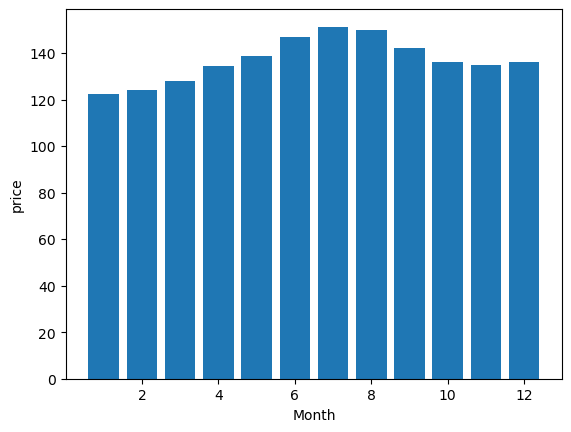

In [92]:
x_data = s['Month']
y_data = s['price']

plt.bar(x_data, y_data)

# Set labels for x and y axes
plt.xlabel('Month')
plt.ylabel('price')

# Show the plot
plt.show()

Now, let's go more detail and do the same price per month analysis seperately for each neighborhood.

In [93]:

# Merge df2 with the selected column from df1 based on the 'ID' column
merged_df = pd.merge(df1, df2[['id','neighbourhood']], left_on='listing_id', right_on='id', how='left')


In [94]:
merged_df.tail()

,listing_id,date,available,price,Month,id,neighbourhood
1393565,10208623,2016-12-29,f,NaN,12,10208623,Queen Anne
1393566,10208623,2016-12-30,f,NaN,12,10208623,Queen Anne
1393567,10208623,2016-12-31,f,NaN,12,10208623,Queen Anne
1393568,10208623,2017-01-01,f,NaN,1,10208623,Queen Anne
1393569,10208623,2017-01-02,f,NaN,1,10208623,Queen Anne


In [95]:
merged_df.shape

(1393570, 7)

In [96]:
s2 =pd.DataFrame(merged_df.loc[df1['available'] =='t'].groupby(['Month', 'neighbourhood'])['price'].mean())
s2.reset_index(drop=False, inplace=True)

In [97]:
s2.head()

,Month,neighbourhood,price
0,1,Alki,199.232409
1,1,Arbor Heights,82.727273
2,1,Atlantic,114.507082
3,1,Ballard,109.902842
4,1,Belltown,158.133207


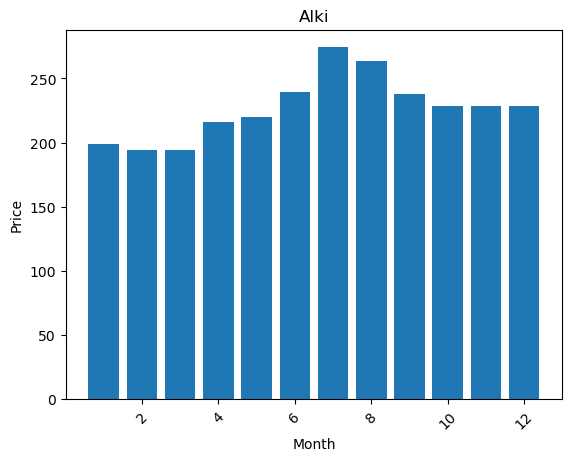

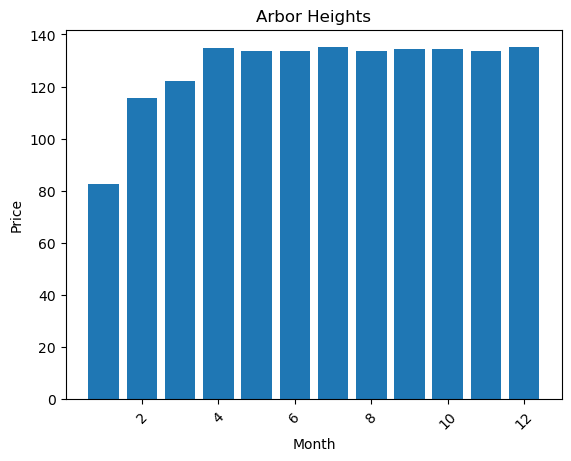

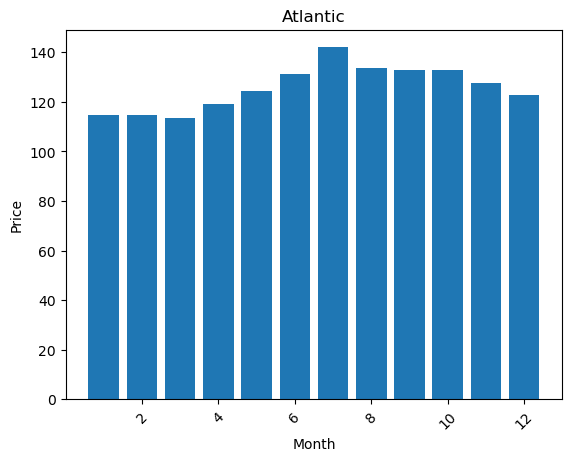

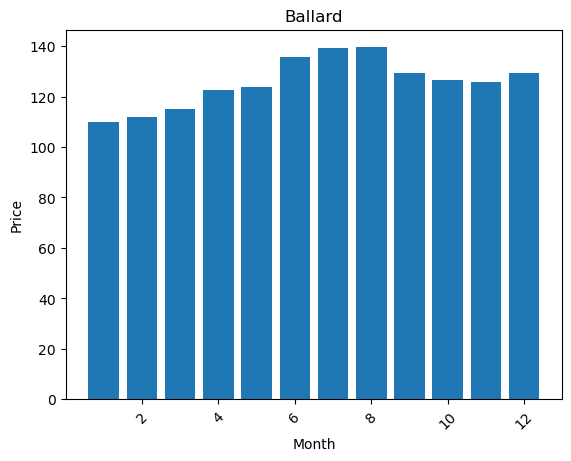

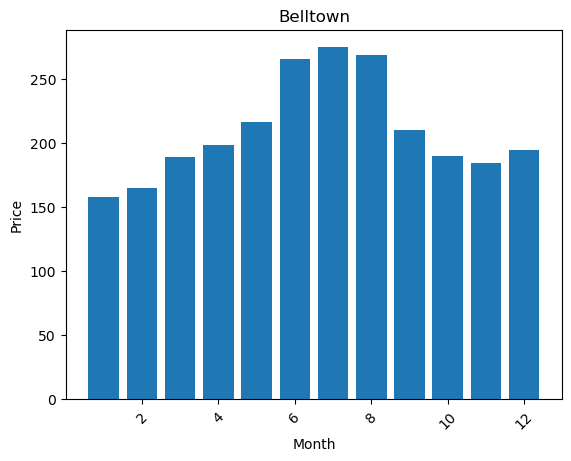

...

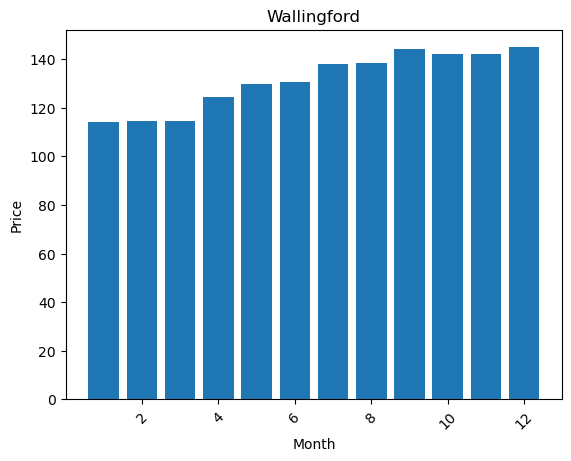

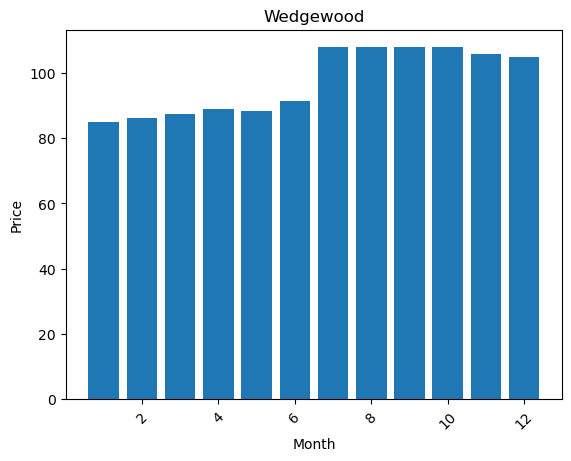

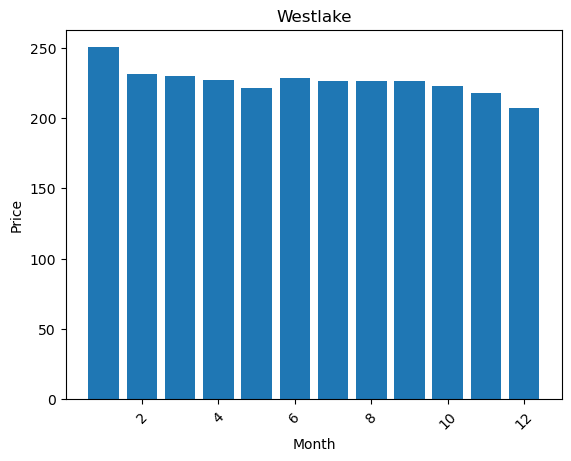

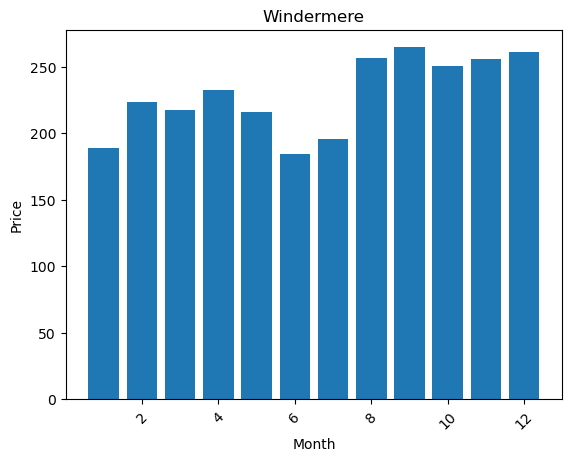

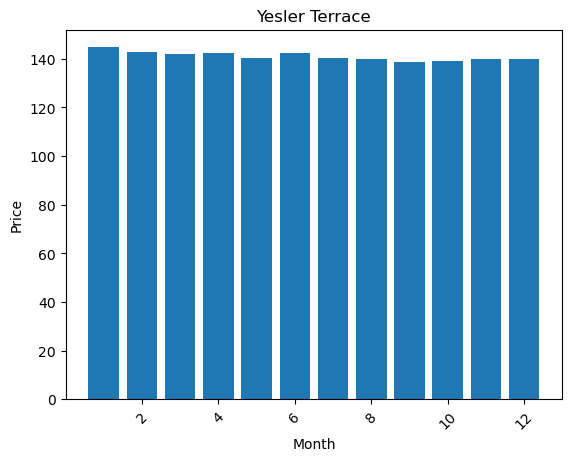

In [99]:

# Group the dataframe by 'neighborhood' column
grouped_df = s2.groupby('neighbourhood')

# Create bar charts for each neighborhood
for neighborhood, data in grouped_df:
    plt.figure()  # Create a new figure for each neighborhood
    plt.bar(data['Month'], data['price'])
    plt.xlabel('Month')
    plt.ylabel('Price')
    plt.title(neighborhood)

    # Optional: Rotate x-axis labels if needed
    plt.xticks(rotation=45)

    # Show the plot for the current neighborhood
    plt.show()

As before, properties seem to be more expensive in July and August.

<h1> Section3: Data Preparation, Analysis & Evaluation

<h2> Question 1: Which Amenities has more impact on Average Review Scores?

In [108]:
# the column names of dataframe df2 in order to find the name of amenity in this dataframe
c1=list(df2.columns)

In [109]:
print(df2['amenities'])

0       {TV,"Cable TV",Internet,"Wireless Internet","A...
1       {TV,Internet,"Wireless Internet",Kitchen,"Free...
2       {TV,"Cable TV",Internet,"Wireless Internet","A...
3       {Internet,"Wireless Internet",Kitchen,"Indoor ...
4       {TV,"Cable TV",Internet,"Wireless Internet",Ki...
                              ...                        
3813    {TV,"Cable TV",Internet,"Wireless Internet","A...
3814    {TV,"Cable TV",Internet,"Wireless Internet",Ki...
3815    {"Cable TV","Wireless Internet",Kitchen,"Free ...
3816    {TV,"Wireless Internet",Kitchen,"Free Parking ...
3817    {TV,"Cable TV",Internet,"Wireless Internet",Ki...
Name: amenities, Length: 3818, dtype: object


<h3> Question 1 Analysis

Let's have a binary column for each amenities in which 1 means the property has this amenity and 0 otherwise.

In [111]:
# delete '"{},' signs from amenities column.
df2['amenities']=df2['amenities'].str.replace('"','')
df2['amenities']=df2['amenities'].str.replace('{','')
df2['amenities']=df2['amenities'].str.replace('}','')
df2['amenities']=df2['amenities'].str.split(',')
df2 = pd.concat([df2,pd.get_dummies(df2['amenities'].apply(pd.Series).stack()).sum(level=0)], axis=1)

C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\1588641760.py:2: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df2['amenities']=df2['amenities'].str.replace('{','')
C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\1588641760.py:3: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df2['amenities']=df2['amenities'].str.replace('}','')
C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\1588641760.py:5: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  df2 = pd.concat([df2,pd.get_dummies(df2['amenities'].apply(pd.Series).stack

In [112]:
del df2['']

In [114]:
df2['amenities']

0       [TV, Cable TV, Internet, Wireless Internet, Ai...
1       [TV, Internet, Wireless Internet, Kitchen, Fre...
2       [TV, Cable TV, Internet, Wireless Internet, Ai...
3       [Internet, Wireless Internet, Kitchen, Indoor ...
4       [TV, Cable TV, Internet, Wireless Internet, Ki...
                              ...                        
3813    [TV, Cable TV, Internet, Wireless Internet, Ai...
3814    [TV, Cable TV, Internet, Wireless Internet, Ki...
3815    [Cable TV, Wireless Internet, Kitchen, Free Pa...
3816    [TV, Wireless Internet, Kitchen, Free Parking ...
3817    [TV, Cable TV, Internet, Wireless Internet, Ki...
Name: amenities, Length: 3818, dtype: object

In [116]:
c2= list(df2.columns)

In [117]:
# "a" is the list of amenities which are now column names
a=list(set(c2)-set(c1))

In [118]:
a

['Free Parking on Premises',
 'Cable TV',
 'Laptop Friendly Workspace',
 'Lock on Bedroom Door',
 'Safety Card',
 'Buzzer/Wireless Intercom',
 'Fire Extinguisher',
 'Shampoo',
 'First Aid Kit',
 'Wheelchair Accessible',
 'Pets Allowed',
 'Smoking Allowed',
 'Suitable for Events',
 'Internet',
 'Family/Kid Friendly',
 'Kitchen',
 'Hair Dryer',
 'Doorman',
 'Cat(s)',
 'Wireless Internet',
 'Hangers',
 'Essentials',
 'Pets live on this property',
 'Washer',
 'Carbon Monoxide Detector',
 '24-Hour Check-in',
 'Washer / Dryer',
 'Hot Tub',
 'Gym',
 'Heating',
 'Dryer',
 'Breakfast',
 'Iron',
 'Smoke Detector',
 'Pool',
 'Dog(s)',
 'Other pet(s)',
 'Indoor Fireplace',
 'TV',
 'Elevator in Building',
 'Air Conditioning']

In [119]:
len(a)

41

In [120]:
df2['review_scores_rating']

0        95.0
1        96.0
2        97.0
3         NaN
4        92.0
        ...  
3813     80.0
3814    100.0
3815      NaN
3816      NaN
3817      NaN
Name: review_scores_rating, Length: 3818, dtype: float64

In [121]:
# Which amenities attracts more satisfaction?
for c in a:
    print(df2.groupby(df2[c])['review_scores_rating'].mean())

Free Parking on Premises
0    93.873123
1    95.021751
Name: review_scores_rating, dtype: float64
Cable TV
0    94.312308
1    94.901720
Name: review_scores_rating, dtype: float64
Laptop Friendly Workspace
0    94.321401
1    95.588991
Name: review_scores_rating, dtype: float64
Lock on Bedroom Door
0    94.530789
1    95.037736
Name: review_scores_rating, dtype: float64
Safety Card
0    94.194586
1    95.951768
Name: review_scores_rating, dtype: float64
Buzzer/Wireless Intercom
0    94.567587
1    94.370614
Name: review_scores_rating, dtype: float64
Fire Extinguisher
0    93.623485
1    95.192328
Name: review_scores_rating, dtype: float64
Shampoo
0    93.146396
1    95.081034
Name: review_scores_rating, dtype: float64
First Aid Kit
0    93.851617
1    95.366921
Name: review_scores_rating, dtype: float64
Wheelchair Accessible
0    94.558108
1    94.322835
Name: review_scores_rating, dtype: float64
Pets Allowed
0    94.575288
1    94.286076
Name: review_scores_rating, dtype: float64
Smok

Based on the difference of the means of review_scores_rating for the two groups (Having or not having the amenity) we can guess having which amenity is important.
But let's check which difference is statistically significant based on p-value

In [204]:
# Define a function to calculate p-value
def calculate_pvalue(group1, group2):
    
    ''' 
    returns a single number showing the p-value
    Input: the two groups for which we want to run the test
    Output: the p-value for our statistical experiment

    '''    
       
    _, pvalue = stats.ttest_ind(group1, group2, nan_policy='omit')
    return pvalue

# Create an empty dataframe to store the results
results_df = pd.DataFrame(columns=['Column', 'Count_0', 'Count_1', 'Avg_Review_Score_0', 'Avg_Review_Score_1', 'p-value'])

# Iterate over the columns
for column in a:  # Exclude the 'review_score' column
    count_0 = df2.loc[df2[column] == 0, column].count()
    count_1 = df2.loc[df2[column] == 1, column].count()
    avg_review_score_0 = df2.loc[df2[column] == 0, 'review_scores_rating'].mean()
    avg_review_score_1 = df2.loc[df2[column] == 1, 'review_scores_rating'].mean()
    
    group_0 = pd.to_numeric(df2.loc[df2[column] == 0, 'review_scores_rating'], errors='coerce')
    group_1 = pd.to_numeric(df2.loc[df2[column] == 1, 'review_scores_rating'], errors='coerce')
    
    if group_0.size < 2 or group_1.size < 2:
        pvalue = None
    else:
        pvalue = calculate_pvalue(group_0, group_1)
    
    results_df = results_df.append({
        'Column': column,
        'Count_0': count_0,
        'Count_1': count_1,
        'Avg_Review_Score_0': avg_review_score_0,
        'Avg_Review_Score_1': avg_review_score_1,
        'p-value': pvalue
    }, ignore_index=True)

# Print the results table
results_df

C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\702942149.py:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\702942149.py:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\702942149.py:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\702942149.py:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
C:\Users\enabi\AppData\Local\Temp\ipykernel_19960\702942149.

,Column,Count_0,Count_1,Avg_Review_Score_0,Avg_Review_Score_1,p-value
0,Free Parking on Premises,1651,2167,93.873123,95.021751,0.000001
1,Cable TV,2372,1446,94.312308,94.901720,0.014468
2,Laptop Friendly Workspace,3073,745,94.321401,95.588991,0.000045
3,Lock on Bedroom Door,3718,100,94.530789,95.037736,0.579671
4,Safety Card,3091,727,94.194586,95.951768,0.0
5,Buzzer/Wireless Intercom,3280,538,94.567587,94.370614,0.555837
6,Fire Extinguisher,1622,2196,93.623485,95.192328,0.0
7,Shampoo,1148,2670,93.146396,95.081034,0.0
8,First Aid Kit,2138,1680,93.851617,95.366921,0.0
9,Wheelchair Accessible,3518,300,94.558108,94.322835,0.586249


<h3>Result Visualization:

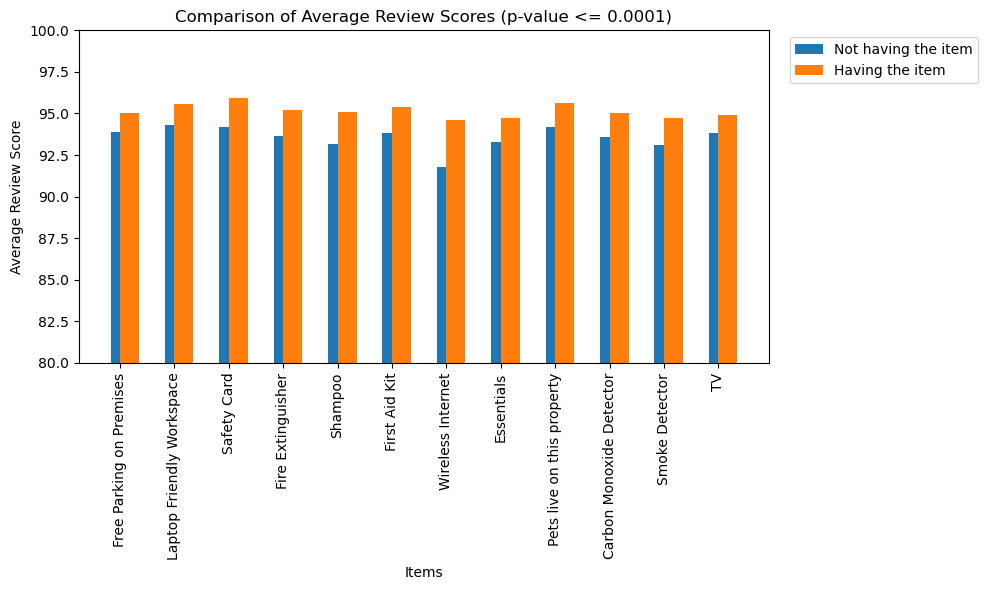

In [256]:
# Now, the bar chart depicts both scenarios (having or not having the item) for the items with a p-value less than 0.001.

# Filter the dataframe based on the condition p-value <= 0.0001
filtered_df = results_df[results_df['p-value'] <= 0.0001]

# Extract the relevant columns
items = filtered_df['Column']
avg_score_0 = filtered_df['Avg_Review_Score_0']
avg_score_1 = filtered_df['Avg_Review_Score_1']

# Create an array for the x-axis positions
x = range(len(items))

# Set the figure size
plt.figure(figsize=(10, 6))

# Plot the bar chart for Avg_Review_Score_0
plt.bar(x, avg_score_0, width=0.35, align='center', label='Not having the item')

# Plot the bar chart for Avg_Review_Score_1
plt.bar(x, avg_score_1, width=0.35, align='edge', label='Having the item')

# Set the x-axis labels and rotate them
plt.xticks(x, items, rotation=90)

# Set the y-axis range
plt.ylim(80, 100)

# Add labels, title, and legend
plt.xlabel('Items')
plt.ylabel('Average Review Score')
plt.title('Comparison of Average Review Scores (p-value <= 0.0001)')
plt.legend(loc='upper left', bbox_to_anchor=(1.02, 1))

# Show the bar chart
plt.tight_layout()
plt.show()

<h3>Result Explanation:

Based on the p-value, Safety Card, Fire Extinguisher, Shampoo, First Aid Kit, Pets live on this property, Carbon Monoxide Detector, etc are significantly important for guest's satisfaction

<h2>Question 2: Which review_scores has the most influence on Average Total Review Score Rating?

<h3> Question 2 Analysis

User satisfaction is of paramount importance in this study, with a particular focus on the total user rating score. Among the seven review scores, 'review_scores_rating' serves as the comprehensive indicator. It is intriguing to examine the relationship between these individual ratings and the overall review score. Such analysis can provide hosts with valuable insights into which specific aspects carry more weight in shaping the overall rating. Armed with this knowledge, hosts can prioritize and enhance these key areas, ultimately elevating the overall guest experience.User satisfaction is of paramount importance in this study, with a particular focus on the total user rating score. Among the seven review scores, 'review_scores_rating' serves as the comprehensive indicator. It is intriguing to examine the relationship between these individual ratings and the overall review score. Such analysis can provide hosts with valuable insights into which specific aspects carry more weight in shaping the overall rating. Armed with this knowledge, hosts can prioritize and enhance these key areas, ultimately elevating the overall guest experience.

In [126]:
# columns related to review_scores
df2[[
 'review_scores_rating',
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value']].head()

,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,95.0,10.0,10.0,10.0,10.0,9.0,10.0
1,96.0,10.0,10.0,10.0,10.0,10.0,10.0
2,97.0,10.0,10.0,10.0,10.0,10.0,10.0
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,92.0,9.0,9.0,10.0,10.0,9.0,9.0


In [ ]:
selected_columns = [
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value']  # List of columns to calculate correlation with
target_column = 'review_scores_rating'  # Column to calculate correlation against

# Select the desired columns from the DataFrame
selected_data = df2[selected_columns + [target_column]]

# Calculate the correlation using the corr() function
corr = selected_data.corr()[target_column]

# Print the correlation values
print(corr)

review_scores_accuracy         0.621257
review_scores_cleanliness      0.642882
review_scores_checkin          0.521813
review_scores_communication    0.540620
review_scores_location         0.368423
review_scores_value            0.696534
review_scores_rating           1.000000
Name: review_scores_rating, dtype: float64


<h3>Result Visualization

Let's visualize the calculated correlations using a heatmap. In the heatmap below, shades of red indicate a higher degree of correlation, while darker shades of blue indicate a lower degree of correlation.

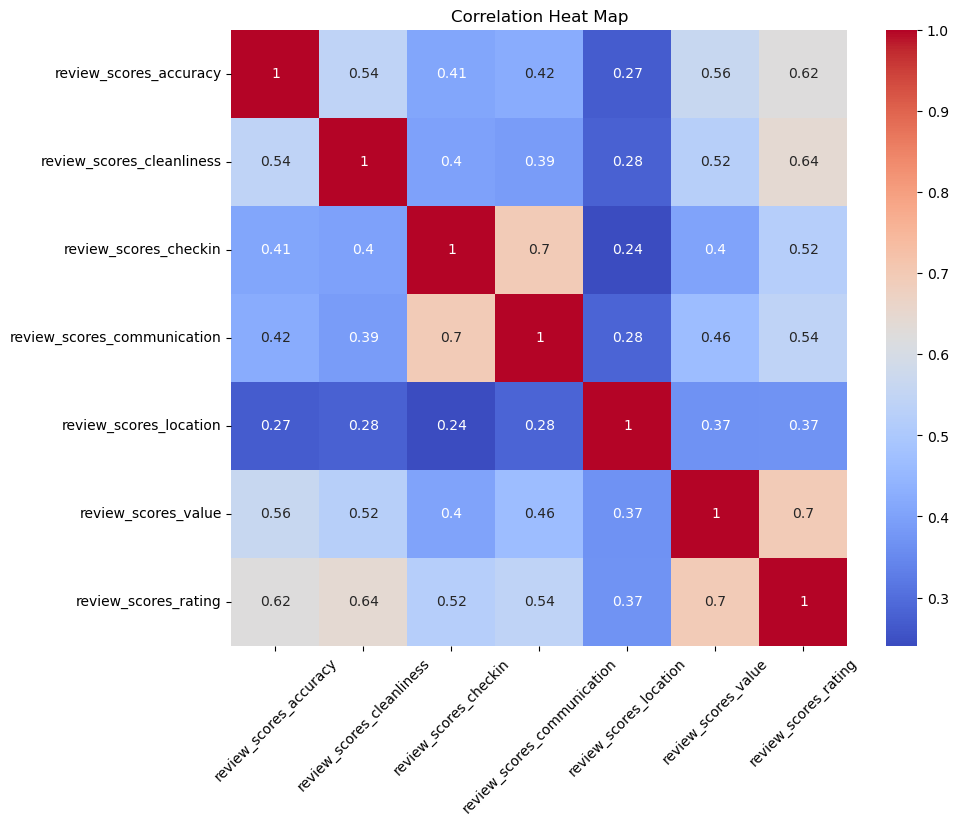

In [229]:
# Plot the correlation as a heat map
correlation = selected_data.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation, annot=True, cmap='coolwarm', square=True)

# Set the plot title
plt.title('Correlation Heat Map')

# Rotate the x-axis labels
plt.xticks(rotation=45)

# Rotate the y-axis labels
plt.yticks(rotation=0)

# Show the plot
plt.show()

<h3>Result Explanation

Based on above calculation, 'review_scores_value' has the highest correlation on total score. After that, it is 'review_scores_cleanliness' and then 'review_scores_accuracy'

<h2> Question 3: Which host charectristics has the most influence on average review scores?

<h3> Question 3 Analysis

In this section, the charestristics related to HOST will be analysed to see which ones have influence on review scores.

In [129]:
# let's see if being superhost is important in order to enhance guest's satisfaction
df2.groupby(df2['host_is_superhost'])['review_scores_rating'].mean()

host_is_superhost
f    93.652893
t    97.395473
Name: review_scores_rating, dtype: float64

In [130]:
g0 = df2.loc[df2['host_is_superhost'] == 'f', 'review_scores_rating'].values
g1 = df2.loc[df2['host_is_superhost'] == 't', 'review_scores_rating'].values

In [131]:
def calculate_pvalue(group1, group2):
    _, pvalue = stats.ttest_ind(group1, group2, nan_policy='omit')
    return pvalue

In [132]:
calculate_pvalue(g0, g1)

4.25626226350552e-43

Since p-value is extremely low, it seems being superhost is a big deal :) let's visualize the average review score for both being/not being superhost.

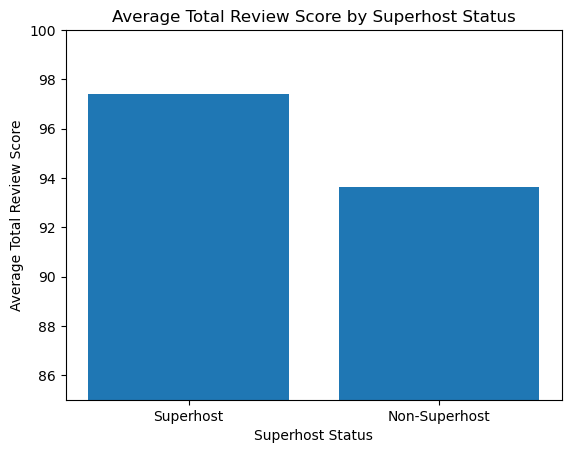

In [259]:
import matplotlib.pyplot as plt

# Calculate the average total review score for superhosts and non-superhosts
avg_score_superhost = df2[df2['host_is_superhost'] == 't']['review_scores_rating'].mean()
avg_score_non_superhost = df2[df2['host_is_superhost'] == 'f']['review_scores_rating'].mean()

# Create a bar chart
x = ['Superhost', 'Non-Superhost']
y = [avg_score_superhost, avg_score_non_superhost]

plt.bar(x, y)

# Set the y-axis range
plt.ylim(85, 100)

# Add labels and title
plt.xlabel('Superhost Status')
plt.ylabel('Average Total Review Score')
plt.title('Average Total Review Score by Superhost Status')

# Display the chart
plt.show()

In [133]:
# another thing to be checked is how long a person is a host (host experience)
df2['host_since']

0       2011-08-11
1       2013-02-21
2       2014-06-12
3       2013-11-06
4       2011-11-29
           ...    
3813    2015-04-13
3814    2015-10-14
3815    2015-12-30
3816    2015-01-03
3817    2014-04-25
Name: host_since, Length: 3818, dtype: object

let's convert the duration of being host to 'Month'

In [134]:
df2['host_since'] = pd.to_datetime(df2['host_since'])

# Calculate the difference between each date and a reference date
reference_date = pd.to_datetime('2023-06-28')  # Replace with your desired reference date
df2['months_since_reference'] = (reference_date.year- df2['host_since'].dt.year) * 12 + (reference_date.month - df2['host_since'].dt.month)

# Print the resulting DataFrame
df2.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,Shampoo,Smoke Detector,Smoking Allowed,Suitable for Events,TV,Washer,Washer / Dryer,Wheelchair Accessible,Wireless Internet,months_since_reference
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,,...,0,0,0,0,1,1,0,0,1,142.0
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",...,0,1,0,0,1,1,0,0,1,124.0


In [135]:
df2[['host_since', 'months_since_reference']]

,host_since,months_since_reference
0,2011-08-11,142.0
1,2013-02-21,124.0
2,2014-06-12,108.0
3,2013-11-06,115.0
4,2011-11-29,139.0
...,...,...
3813,2015-04-13,98.0
3814,2015-10-14,92.0
3815,2015-12-30,90.0
3816,2015-01-03,101.0


In [136]:
df2['months_since_reference'].min()

89.0

In [137]:
df2['months_since_reference'].max()

175.0

In [138]:
df2.groupby(['months_since_reference'])['review_scores_rating'].mean()

months_since_reference
89.0           NaN
90.0     97.500000
91.0     96.480000
92.0     95.093750
93.0     95.111111
           ...    
170.0    92.000000
171.0    95.500000
172.0    96.500000
173.0    96.000000
175.0    89.666667
Name: review_scores_rating, Length: 85, dtype: float64

It seems "host_since" is not an effective factor for enhancing user score. To better understanding let's bucket the month of being host values into 10 bins

<h3> Visualization

Again, this bar chart gives us a same conclusion that the duration of being host does not make any difference in user satisfaction score

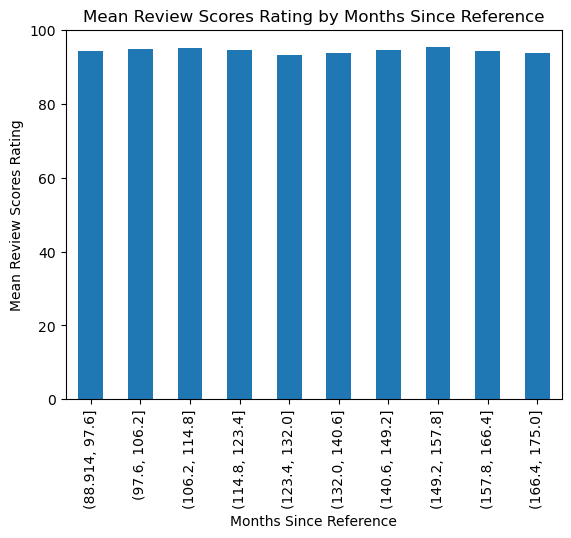

In [139]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(df2['months_since_reference'], bins=10)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('Months Since Reference')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by Months Since Reference')
plt.show()

In [140]:
# check if having profile pic is statistically increase user rating?
df2.groupby(['host_has_profile_pic'])['review_scores_rating'].mean()

host_has_profile_pic
f    97.800000
t    94.534112
Name: review_scores_rating, dtype: float64

In [141]:
g0 = df2.loc[df2['host_has_profile_pic'] == 'f', 'review_scores_rating'].values
g1 = df2.loc[df2['host_has_profile_pic'] == 't', 'review_scores_rating'].values

In [142]:
def calculate_pvalue(group1, group2):
    _, pvalue = stats.ttest_ind(group1, group2, nan_policy='omit')
    return pvalue

In [143]:
calculate_pvalue(g0, g1)

0.2694062607489123

NO! it does not matter if the host has a profile pic. and actually the average of rating is a little bit less when the host has picture :))))

In [144]:
# check if the number of total listings has impact on user rating?

In [147]:
# first, let's check what we have in 'host_total_listings_count' column
df2['host_total_listings_count'].value_counts(dropna=False)

1.0      2179
2.0       620
3.0       261
4.0       151
5.0        98
34.0       67
6.0        48
48.0       46
169.0      39
37.0       37
36.0       36
7.0        30
9.0        28
10.0       26
8.0        23
11.0       22
21.0       21
18.0       19
17.0       16
12.0       12
13.0       12
354.0      10
19.0        4
163.0       4
15.0        3
502.0       2
NaN         2
84.0        2
Name: host_total_listings_count, dtype: int64

In [148]:
df2.groupby(['host_total_listings_count'])['review_scores_rating'].mean()

host_total_listings_count
1.0      95.279748
2.0      94.233273
3.0      94.938865
4.0      93.983740
5.0      93.988235
6.0      94.179487
7.0      90.826087
8.0      92.227273
9.0      93.814815
10.0     94.826087
11.0     87.666667
12.0     95.714286
13.0     97.750000
15.0     91.333333
17.0     87.300000
18.0     92.526316
19.0     80.000000
21.0     92.761905
34.0     86.338462
36.0     92.931034
37.0     89.857143
48.0     97.121951
84.0     91.500000
163.0    97.500000
169.0    93.648649
354.0    90.000000
502.0    67.500000
Name: review_scores_rating, dtype: float64

In [152]:
#To provide a clearer and simplified overview, the analysis has excluded properties with a count larger than 100. This decision was made to focus on a subset of data that allows for a more straightforward and easier understanding of the overall picture. 
h= df2.loc[df2['host_total_listings_count']<100].groupby('host_total_listings_count')['review_scores_rating'].mean()
h= h.reset_index()

In [154]:
h.head()

,host_total_listings_count,review_scores_rating
0,1.0,95.279748
1,2.0,94.233273
2,3.0,94.938865
3,4.0,93.983740
4,5.0,93.988235


In [155]:
h.shape

(23, 2)

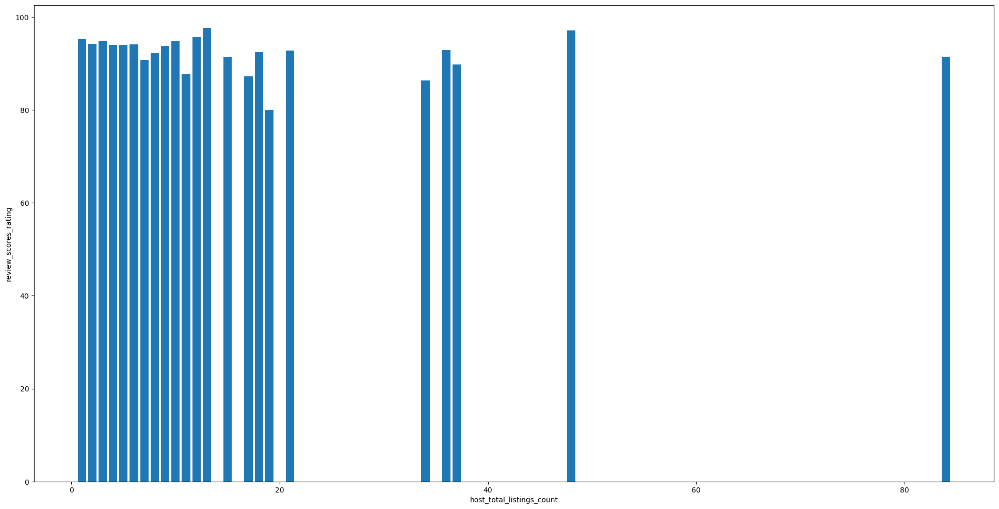

In [153]:
# let's visualize if having more/ less listings depict higher/ lower rating score?
x_data = h['host_total_listings_count']
y_data = h['review_scores_rating']
plt.figure(figsize=(24, 12))
plt.bar(x_data, y_data)

# Set labels for x and y axes
plt.xlabel('host_total_listings_count')
plt.ylabel('review_scores_rating')

# Show the plot
plt.show()

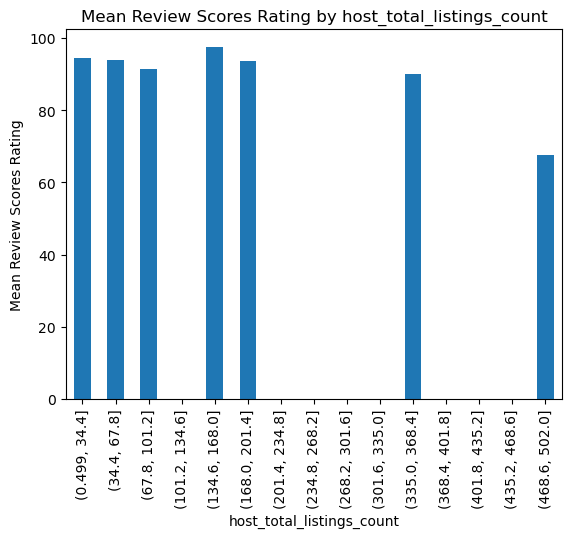

In [159]:
# In order to keep all the numbers of total listings, let's bucket them in to 15 bins and the visualize the review score over it
intervals = pd.cut(df2['host_total_listings_count'], bins=15)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('host_total_listings_count')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by host_total_listings_count')
plt.show()

In [161]:
# It seems that there is no obvious relationship between the above mentioned two variables.

I personally expect that the higher response rate, the higher rating sore, let's see what data says!

In [162]:
df2['host_response_rate'].value_counts(dropna=False)

100%    2371
NaN      523
90%      165
80%      104
99%       78
88%       66
50%       52
94%       46
67%       41
89%       32
75%       32
86%       30
98%       28
96%       28
70%       25
97%       21
60%       20
83%       20
93%       18
92%       18
33%       14
40%       12
63%       11
71%        8
95%        8
78%        8
91%        5
43%        4
64%        3
76%        3
87%        3
25%        3
57%        2
82%        2
17%        2
58%        2
53%        1
65%        1
69%        1
68%        1
30%        1
56%        1
38%        1
81%        1
31%        1
55%        1
Name: host_response_rate, dtype: int64

In [175]:
g1= df2.groupby('host_response_rate')['review_scores_rating'].mean()
g1= g1.reset_index()

In [180]:
g1['host_response_rate'].dtypes

dtype('int64')

Since responce rate is not numeric, first we should convert it to numbers.

In [177]:
g1['host_response_rate']= g1['host_response_rate'].str.replace('%', '')

In [178]:
g1['host_response_rate']= pd.to_numeric(g1['host_response_rate'])

In [181]:
sorted_df= g1.sort_values(by='host_response_rate')
sorted_df.head()

,host_response_rate,review_scores_rating
1,17,100.000000
2,25,97.500000
3,30,100.000000
4,31,97.000000
5,33,90.818182


let's plot these two column against each other and see the pattern.

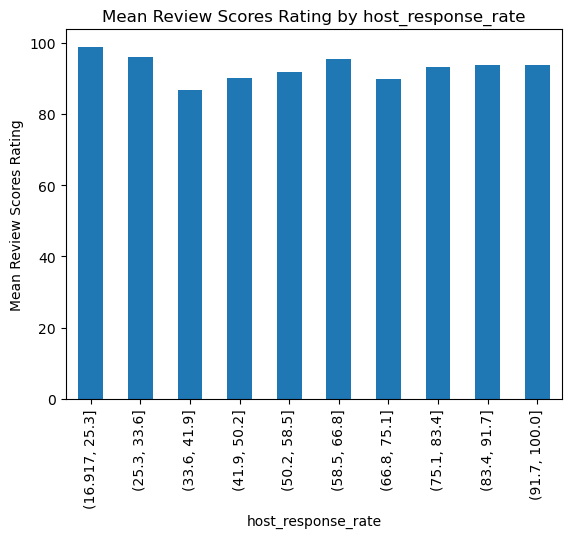

In [182]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(g1['host_response_rate'], bins=10)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = g1.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('host_response_rate')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by host_response_rate')
plt.show()

Not very happy with our prediction :) It seems having high host response rate does not really enhance review rating scores!

Next host charectristic to dig in to more is cancellation_policy

In [183]:
df2['cancellation_policy'].value_counts(dropna=False)

strict      1417
moderate    1251
flexible    1150
Name: cancellation_policy, dtype: int64

In [184]:
df2.groupby('cancellation_policy')['review_scores_rating'].mean()

cancellation_policy
flexible    94.810256
moderate    94.671958
strict      94.251392
Name: review_scores_rating, dtype: float64

Not really different from each other!

<h3> Result Explanation:

Based on the analysis and visualizations, the standout host characteristic that significantly impacts the guest's average review score is whether the host is a superhost. This finding suggests that being a superhost has a substantial influence on achieving higher guest satisfaction and overall review scores.

<h2> Question 4: Which property charectristics has the most influence on average review scores?

<h3> Question 4 Analysis & visualizations

Let's explore the impact of property-related features on the average review score.
First, let's start with the number of reviews of a property.

In [186]:
df2['number_of_reviews'].value_counts(dropna=False)

0      627
1      310
2      224
4      160
3      157
      ... 
179      1
138      1
190      1
270      1
128      1
Name: number_of_reviews, Length: 195, dtype: int64

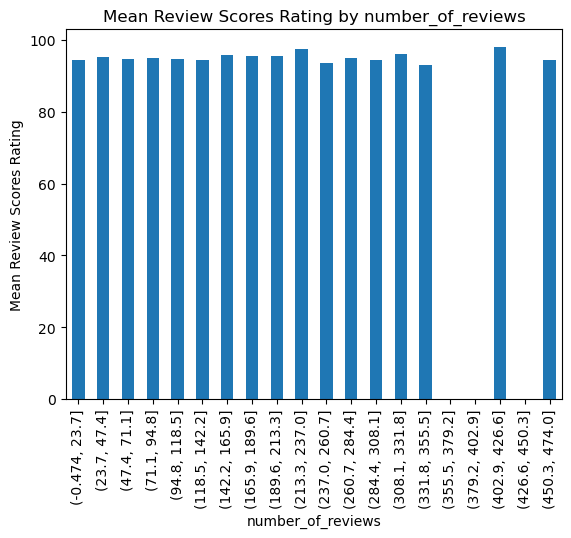

In [187]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(df2['number_of_reviews'], bins=20)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('number_of_reviews')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by number_of_reviews')
plt.show()

It seems No!

In [188]:
#Does the number of people accommodated in a property have any impact on the average rating score of the house?

In [189]:
df2['accommodates'].value_counts(dropna=False)

2     1627
4      785
3      398
6      332
1      256
5      184
8      119
7       52
10      25
12      15
9       13
16       4
11       3
14       3
15       2
Name: accommodates, dtype: int64

In [190]:
df2.groupby('accommodates')['review_scores_rating'].mean()

accommodates
1     93.284153
2     94.843036
3     94.552023
4     94.503900
5     94.123457
6     94.605634
7     94.714286
8     93.214286
9     97.909091
10    91.956522
11    97.000000
12    95.133333
14    95.666667
15    97.000000
16    97.500000
Name: review_scores_rating, dtype: float64

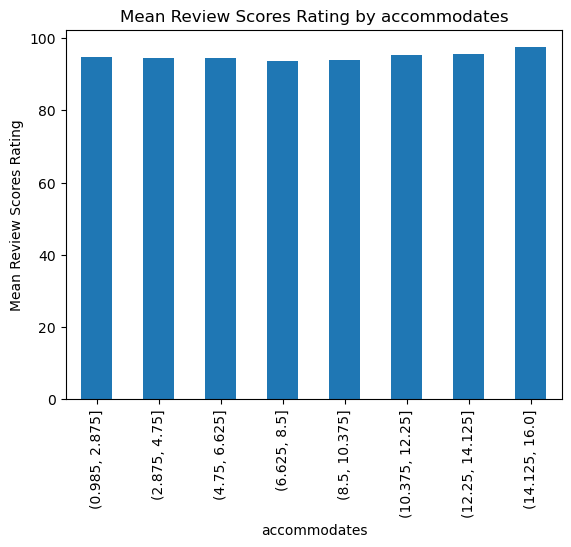

In [191]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(df2['accommodates'], bins=8)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('accommodates')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by accommodates')
plt.show()

Again! It seems the answer is NO! But at the same time it appears that higher accommodates have higher average review score!

In [192]:
# This part sorts and demostrates the neighborhoods based on the average review scores.
import textwrap
# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby('neighbourhood')['review_scores_rating'].mean()
new_df= pd.DataFrame({'neighbourhood': grouped_df.index, 'mean_rating': grouped_df.values})
new_df = new_df.sort_values(by='mean_rating', ascending=False)


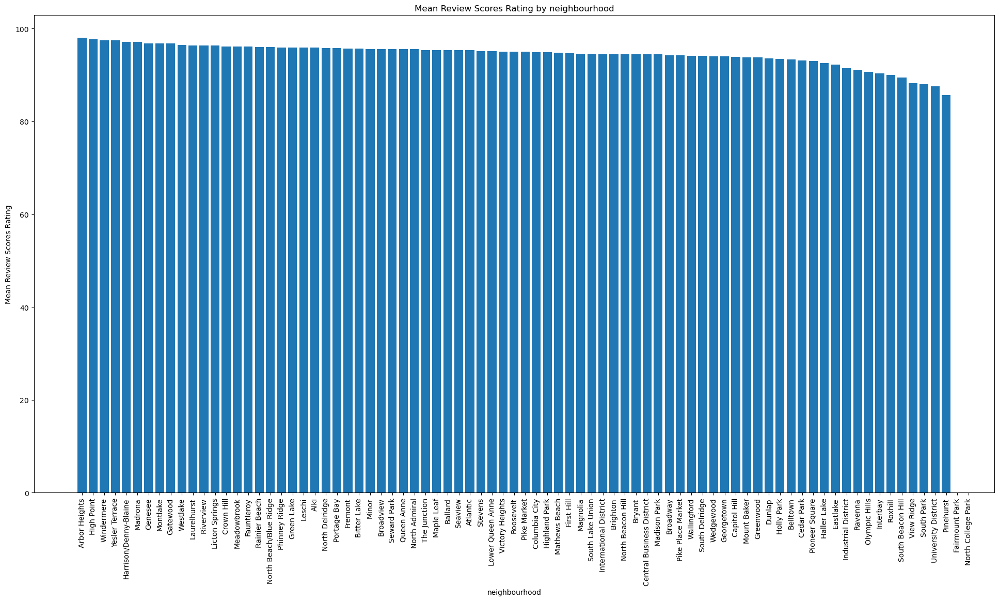

In [193]:
# Plot the bar chart
x_data = new_df['neighbourhood']
y_data = new_df['mean_rating']
plt.figure(figsize=(24, 12))
plt.bar(x_data, y_data)
plt.xticks(rotation=90)
plt.xlabel('neighbourhood')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by neighbourhood')

plt.show()

The highest average review score is for Arbor heights neighborhood and the lowest one is for pinehurst

In [198]:
# Checking average review score based on room type and the type of property

In [195]:
df2['room_type'].value_counts(dropna=False)

Entire home/apt    2541
Private room       1160
Shared room         117
Name: room_type, dtype: int64

In [196]:
grouped_df = df2.groupby('room_type')['review_scores_rating'].mean()
new_df= pd.DataFrame({'room_type': grouped_df.index, 'mean_rating': grouped_df.values})
new_df = new_df.sort_values(by='mean_rating', ascending=False)


In [197]:
new_df

,room_type,mean_rating
1,Private room,94.802935
0,Entire home/apt,94.477647
2,Shared room,93.228261


It seems Private room has the highest and shared room has the lowest mean of ratings

In [ ]:
df2['property_type'].value_counts(dropna=False)

House              1733
Apartment          1708
Townhouse           118
Condominium          91
Loft                 40
Bed & Breakfast      37
Other                22
Cabin                21
Camper/RV            13
Bungalow             13
Boat                  8
Tent                  5
Treehouse             3
Dorm                  2
Chalet                2
Yurt                  1
NaN                   1
Name: property_type, dtype: int64

In [199]:
grouped_df = df2.groupby('property_type')['review_scores_rating'].mean()
new_df= pd.DataFrame({'property_type': grouped_df.index, 'mean_rating': grouped_df.values})
new_df = new_df.sort_values(by='mean_rating', ascending=False)
new_df

,property_type,mean_rating
15,Yurt,100.000000
3,Bungalow,97.666667
13,Townhouse,96.625000
11,Other,96.263158
4,Cabin,96.238095
14,Treehouse,96.000000
1,Bed & Breakfast,95.730769
5,Camper/RV,95.700000
2,Boat,95.600000
10,Loft,95.454545


Yurt has the highest and Chalet has the lowest average score for rating!

<h3> Result Explanation:

It seems higher acoomodats, some neighborhoods such as Arbor heights and high point, private room type, Yurt and bungalow type of peoperty have the higher average score compared to other options within their respective categories.